# Notebook 기본 세팅

In [1]:
# Constant 선언

# 프로젝트 루트 디렉토리를 식별하기 위한 마커 파일 이름
ROOT_MARKER = "pyproject.toml"

# 한글 표시를 위한 나눔바른고딕 폰트 파일 이름
# matplotlib 의 font_manager 에 실제 폰트 파일의 위치를 넣어주어야 한다.
KOREAN_FONT_FILE = "NanumBarunGothic.ttf"

# matplotlib 에서는 font-family 의 이름으로 font 를 설정한다.
# 그래서 font 파일 그 자체가 아니라, 그 파일의 family 이름을 적어준다.
KOREAN_FONT_FAMILY = "NanumBarunGothic"

# 참고
# Font Family 와 Font File 의 차이는,
# Font Family 는 비슷한 디자인 특성을 공유하는 글꼴 그룹을 의미한다.
#
# 예를 들어 '나눔바른고딕' 폰트 패밀리는 일반(Regular), 굵게(Bold), 기울임(Italic) 등 여러 스타일을 포함할 수 있다.
# 반면, 폰트 파일(.ttf, .otf 등)은 이러한 폰트의 하나의 스타일이 저장된 실제 파일이다.
#
# 이 프로젝트에서는 폰트 용량을 줄이기 위해 일반(Regular) 인 NanumBarunGothic.ttf 만 사용한다.

In [2]:
# 프로젝트 root 를 sys.path 에 추가해서 import 구문을 사용하기 쉽게
from pathlib import Path


def find_project_root() -> Path:
    """
    pyproject.toml 파일을 기준으로 루트 디렉토리를 찾는다.
    :return: Path: 프로젝트 루트 디렉토리 경로
    """

    current_path = Path().resolve()

    while current_path != current_path.parent:
        if (current_path / ROOT_MARKER).exists():
            return current_path

        current_path = current_path.parent

    raise FileNotFoundError("프로젝트 루트 디렉토리를 찾을 수 없습니다.")


ROOT_DIR = find_project_root()
DATA_DIR = ROOT_DIR / "data"

In [39]:
# matplotlib 의 한글 font 설정
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt


FONTS_DATA_DIR = DATA_DIR / "fonts"


def setup_korean_font():
    font_path = FONTS_DATA_DIR / KOREAN_FONT_FILE
    fm.fontManager.addfont(font_path)

    # 폰트 설정
    plt.rcParams["font.family"] = KOREAN_FONT_FAMILY
    plt.rcParams["axes.unicode_minus"] = False


setup_korean_font()

# Train 데이터셋과 Test 데이터셋에 대한 EDA

## 1. Train 데이터셋 데이터 기본 정보

### 분석 항목

- 전체 이미지 수 확인 (1,570개 맞는지)
- 클래스 수 확인 (17개 맞는지)
- 파일 형식 분포 (JPG, PNG 등)

In [4]:
RAW_DATA_DIR = DATA_DIR / "raw"
TRAIN_DATA_DIR = RAW_DATA_DIR / "train"
TEST_DATA_DIR = RAW_DATA_DIR / "test"

TRAIN_META_FILE_NAME = "train.csv"
TEST_META_FILE_NAME = "sample_submission.csv"

In [5]:
import pandas as pd


train_img_meta_df = pd.read_csv(RAW_DATA_DIR / TRAIN_META_FILE_NAME)
train_img_meta_df.head()

,ID,target
0,002f99746285dfdd.jpg,16
1,008ccd231e1fea5d.jpg,10
2,008f5911bfda7695.jpg,10
3,009235e4c9c07af5.jpg,4
4,00b2f44967580c74.jpg,16


- 결측치 없음

In [6]:
train_img_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1570 entries, 0 to 1569
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   ID      1570 non-null   object
 1   target  1570 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 24.7+ KB


- 전체 이미지 수 확인
    - 총 1,570 개의 이미지가 실제로 있음.

In [7]:
train_img_meta_df["ID"].apply(lambda x: (TRAIN_DATA_DIR / x).exists()).sum()

np.int64(1570)

- 총 class 의 종류 확인
    - 17 개의 `target` 이 있음을 확인

In [8]:
print("종류 수:", train_img_meta_df["target"].nunique())
print(train_img_meta_df["target"].unique())

종류 수: 17
[16 10  4  5 15 14  9 13  7 11  2  8 12  3  0  1  6]


In [9]:
filename_df = train_img_meta_df["ID"].str.split(".", expand=True).rename(columns={0: "filename", 1: "ext"})
filename_df.head()

,filename,ext
0,002f99746285dfdd,jpg
1,008ccd231e1fea5d,jpg
2,008f5911bfda7695,jpg
3,009235e4c9c07af5,jpg
4,00b2f44967580c74,jpg


- 확장자는 jpg 밖에 없음

In [10]:
filename_df["ext"].unique()

array(['jpg'], dtype=object)

## 2. Train 데이터셋의 클래스 분포 분석

### 분석 항목

- 클래스별 이미지 개수 (막대 그래프)
- 클래스 불균형 정도 (최대/최소 비율)
- 소수 클래스 식별 (<50개 또는 <100개)
- 클래스명과 실제 이미지 일치도 검증 (샘플링 확인)
- 비슷한 클래스 그룹핑 (의료서류 vs 신분증 vs 차량 등)

- 클래스별 이미지 개수

### 17개 class 확인

In [11]:
class_meta_df = pd.read_csv(RAW_DATA_DIR / "meta.csv")
class_meta_df = class_meta_df.set_index("target")
class_meta_df

,class_name
target,
0,account_number
1,application_for_payment_of_pregnancy_medical_e...
2,car_dashboard
3,confirmation_of_admission_and_discharge
4,diagnosis
5,driver_lisence
6,medical_bill_receipts
7,medical_outpatient_certificate
8,national_id_card


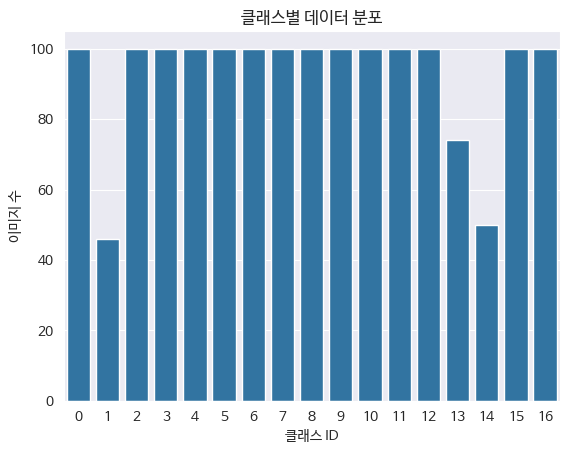

In [12]:
import seaborn as sns


counts_per_class = train_img_meta_df["target"].value_counts().sort_index()

sns.barplot(counts_per_class)

plt.xlabel("클래스 ID")
plt.ylabel("이미지 수")
plt.title("클래스별 데이터 분포")
plt.show()

In [13]:
counts_per_class[counts_per_class != 100]

target
1     46
13    74
14    50
Name: count, dtype: int64

In [14]:
class_meta_df.loc[counts_per_class[counts_per_class < 100].index]

,class_name
target,
1,application_for_payment_of_pregnancy_medical_e...
13,resume
14,statement_of_opinion


- 3개의 클래스를 제외하고 모든 클래스의 이미지 수는 100장이다.
- 클래스 1(application_for_payment_of_pregnancy_medical_expenses), 클래스 13(resume), 클래스 14(statement_of_opinion)의 이미지 수는 각각 46개, 74개, 50개이다.

### 17개 클래스의 sample image

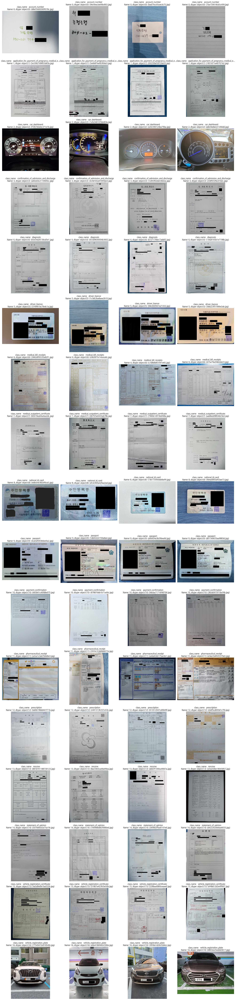

In [15]:
from PIL import Image


def show_sample_images_of_train_per_class():
    filenames_per_class_df = train_img_meta_df.groupby("target").sample(n=4, random_state=42)[["target", "ID"]]

    fig, axes = plt.subplots(nrows=17, ncols=4, figsize=(20, 17 * 5))  # 4장씩 17종류
    fig.patch.set_facecolor("white")
    last_target_class = None
    class_idx = 0
    img_idx = 0
    for _, row in filenames_per_class_df.iterrows():
        target_class = row["target"]
        filename = row["ID"]

        if last_target_class is not None and last_target_class != target_class:
            class_idx += 1
            img_idx = 0

        img_path = TRAIN_DATA_DIR / filename
        class_name = str(class_meta_df.loc[target_class])
        with Image.open(img_path) as img:
            ax = axes[class_idx, img_idx]
            ax.set_facecolor("white")
            ax.imshow(img)
            ax.set_title(f"{class_name}({target_class!s}) ({img_path.name})")
            ax.axis("off")

        img_idx += 1
        last_target_class = target_class

    plt.tight_layout()
    plt.show()


show_sample_images_of_train_per_class()

## 3. Test 이미지 데이터셋 데이터 기본 정보

### 분석 항목

- 전체 이미지 수 확인
- 파일 형식 확인
- 모든 이미지가 있는지 확인

In [16]:
test_img_meta_df = pd.read_csv(RAW_DATA_DIR / TEST_META_FILE_NAME)
test_img_meta_df.head()

,ID,target
0,0008fdb22ddce0ce.jpg,0
1,00091bffdffd83de.jpg,0
2,00396fbc1f6cc21d.jpg,0
3,00471f8038d9c4b6.jpg,0
4,00901f504008d884.jpg,0


- test 용 메타 데이터에는 결측치 없음

In [17]:
test_img_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3140 entries, 0 to 3139
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   ID      3140 non-null   object
 1   target  3140 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 49.2+ KB


- 총 3,140 개의 이미지가 모두 존재함

In [18]:
test_img_meta_df["ID"].apply(lambda x: (TEST_DATA_DIR / x).exists()).sum()

np.int64(3140)

- 이미지 파일의 확장자는 `jpg` 만 있음

In [19]:
test_img_meta_df["ID"].str.split(".", expand=True).rename(
    columns={0: "filename", 1: "ext"}  # ID 를 파일 이름과 확장자로 split
)["ext"].unique()

array(['jpg'], dtype=object)

### Test 샘플 이미지

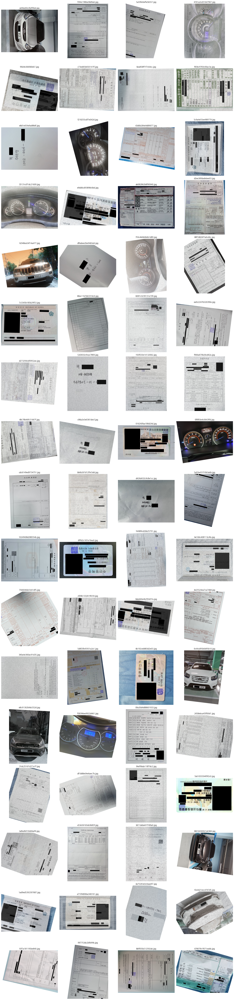

In [20]:
def show_sample_images_of_test():
    sampled_image_ids = test_img_meta_df.sample(17 * 4, random_state=42)["ID"]

    fig, axes = plt.subplots(nrows=17, ncols=4, figsize=(20, 17 * 5))
    fig.patch.set_facecolor("white")
    axes = axes.flatten()

    for idx, image_id in enumerate(sampled_image_ids):
        img_path = TEST_DATA_DIR / image_id
        with Image.open(img_path) as img:
            ax = axes[idx]
            ax.set_facecolor("white")
            ax.imshow(img)
            ax.set_title(image_id)
            ax.axis("off")
    plt.tight_layout()
    plt.show()


show_sample_images_of_test()

## 4. Train 이미지 특성 추출

- 스크립트를 이용해서 다음 특성을 추출

| 특성 이름                   | 데이터 타입 | 의미                                     |
|-------------------------|--------|----------------------------------------|
| `width`                 | int    | 이미지의 너비 (픽셀)                           |
| `height`                | int    | 이미지의 높이 (픽셀)                           |
| `channels`              | int    | 이미지의 채널 수 (1: 그레이스케일, 3: BGR, 4: BGRA) |
| `aspect_ratio`          | float  | 이미지의 가로세로 비율 (너비/높이)                   |
| `file_size_kb`          | int    | 이미지 파일 크기 (킬로바이트)                      |
| `color_mode`            | str    | 이미지의 색상 모드 (GRAY, BGR, BGRA, UNKNOWN)  |
| `total_pixels`          | int    | 이미지의 총 픽셀 수 (너비 × 높이)                  |
| `brightness`            | float  | 이미지의 평균 밝기 (0-255)                     |
| `contrast`              | float  | 이미지의 대비 (그레이스케일 표준편차)                  |
| `sharpness`             | float  | 이미지의 선명도 (라플라시안 변환의 분산)                |
| `edge_ratio`            | float  | 이미지의 엣지 비율 (엣지 픽셀 수 / 총 픽셀 수)          |
| `b_mean`                | float  | 파란색 채널의 평균 값 (0-255)                   |
| `g_mean`                | float  | 초록색 채널의 평균 값 (0-255)                   |
| `r_mean`                | float  | 빨간색 채널의 평균 값 (0-255)                   |
| `saturation`            | float  | 이미지의 평균 채도 (HSV 색 공간)                  |
| `hue`                   | float  | 이미지의 평균 색조 (HSV 색 공간)                  |
| `text_density`          | float  | 텍스트 밀도 (검은색 픽셀 비율)                     |
| `white_space_ratio`     | float  | 여백 비율 (흰색 픽셀 비율)                       |
| `noise_level`           | float  | 이미지의 노이즈 수준 (라플라시안 변환의 표준편차)           |
| `blur_metric`           | float  | 이미지의 흐림 정도 (라플라시안 변환의 분산)              |
| `jpeg_quality_estimate` | float  | 추정된 JPEG 품질 (0-100)                    |
| `histogram_entropy`     | float  | 히스토그램의 엔트로피 (이미지 정보량)                  |
| `histogram_skewness`    | float  | 히스토그램의 왜도 (분포의 비대칭성)                   |
| `histogram_kurtosis`    | float  | 히스토그램의 첨도 (분포의 뾰족함)                    |
| `skew_angle`            | float  | 이미지의 기울어진 각도 (도 단위)                    |
| `is_rotated_90`         | bool   | 이미지가 90도 회전되었는지 여부                     |
| `margin_uniformity`     | float  | 여백의 균일성 (여백 평균값의 표준편차)                 |
| `has_black_borders`     | bool   | 검은색 테두리가 있는지 여부                        |
| `frequency_energy`      | float  | 고주파 에너지 (푸리에 변환의 고주파 영역 에너지)           |
| `gradient_magnitude`    | float  | 그래디언트 크기 (소벨 필터의 평균 크기)                |
| `local_contrast_std`    | float  | 로컬 대비의 표준편차                            |
| `texture_complexity`    | float  | 텍스처 복잡도 (그래디언트 크기 × 로컬 대비 표준편차)        |

- `extract_image_features.py` 스크립트를 사용해서 미리 특성을 추출해둠

In [21]:
train_props_df = pd.read_csv(RAW_DATA_DIR / "train_props.csv")
train_props_df

,width,height,channels,aspect_ratio,file_size_kb,color_mode,total_pixels,brightness,contrast,sharpness,...,histogram_kurtosis,skew_angle,is_rotated_90,margin_uniformity,has_black_borders,frequency_energy,gradient_magnitude,local_contrast_std,texture_complexity,target
0,443,591,3,0.749577,136,BGR,261813,112.680257,70.051393,4460.389379,...,-1.098887,-2.000008,True,31.442979,False,1.937211e+06,109.222272,18.566020,2027.822881,16
1,443,591,3,0.749577,69,BGR,261813,157.959471,29.099328,1630.407911,...,9.090043,-1.000000,True,8.686534,False,1.772975e+06,55.418919,14.825673,821.622745,10
2,443,591,3,0.749577,86,BGR,261813,160.815968,34.911001,3522.282057,...,5.035128,-2.000008,True,14.132011,False,1.866081e+06,77.304771,17.961894,1388.540065,10
3,443,591,3,0.749577,68,BGR,261813,145.534313,38.807893,1140.776069,...,4.219767,0.000000,True,23.701841,False,1.753629e+06,42.903243,13.655979,585.885792,4
4,443,591,3,0.749577,127,BGR,261813,101.450199,56.006780,1589.828807,...,-0.688663,-1.000000,True,19.016270,False,1.838209e+06,74.768330,11.029569,824.662424,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1565,443,591,3,0.749577,66,BGR,261813,157.565178,37.056381,1478.367995,...,7.385806,0.000000,True,17.390223,False,1.765308e+06,46.932968,14.973736,702.761886,4
1566,443,591,3,0.749577,53,BGR,261813,149.152021,24.900689,1054.372951,...,14.258239,0.000000,True,13.476462,False,1.750554e+06,30.177693,11.913248,359.514331,7
1567,591,443,3,1.334086,89,BGR,261813,167.815888,38.867395,2019.553467,...,4.114308,6.000000,True,15.073529,False,1.841018e+06,61.366312,15.749893,966.512852,11
1568,722,362,3,1.994475,47,BGR,261364,188.088578,87.594119,940.389243,...,0.356985,0.000000,True,6.458770,False,1.830660e+06,37.757900,16.785726,633.793777,5


In [22]:
train_props_df.columns

Index(['width', 'height', 'channels', 'aspect_ratio', 'file_size_kb',
       'color_mode', 'total_pixels', 'brightness', 'contrast', 'sharpness',
       'edge_ratio', 'b_mean', 'g_mean', 'r_mean', 'saturation', 'hue',
       'text_density', 'white_space_ratio', 'noise_level', 'blur_metric',
       'jpeg_quality_estimate', 'histogram_entropy', 'histogram_skewness',
       'histogram_kurtosis', 'skew_angle', 'is_rotated_90',
       'margin_uniformity', 'has_black_borders', 'frequency_energy',
       'gradient_magnitude', 'local_contrast_std', 'texture_complexity',
       'target'],
      dtype='object')

In [23]:
train_props_df.describe().T

,count,mean,std,min,25%,50%,75%,max
width,1570.0,4.976134e+02,79.370316,3.840000e+02,4.430000e+02,4.430000e+02,5.910000e+02,7.530000e+02
height,1570.0,5.381694e+02,76.074772,3.480000e+02,4.430000e+02,5.910000e+02,5.910000e+02,6.820000e+02
channels,1570.0,3.000000e+00,0.000000,3.000000e+00,3.000000e+00,3.000000e+00,3.000000e+00,3.000000e+00
aspect_ratio,1570.0,9.700074e-01,0.323053,5.630499e-01,7.495770e-01,7.495770e-01,1.334086e+00,2.163793e+00
file_size_kb,1570.0,7.662357e+01,21.264676,2.400000e+01,6.200000e+01,7.500000e+01,9.000000e+01,1.630000e+02
total_pixels,1570.0,2.617799e+05,120.726659,2.611840e+05,2.618130e+05,2.618130e+05,2.618130e+05,2.621440e+05
brightness,1570.0,1.481887e+02,35.401050,1.698916e+01,1.267486e+02,1.564868e+02,1.740204e+02,2.103924e+02
contrast,1570.0,4.755603e+01,19.152186,1.012682e+01,3.347419e+01,4.138241e+01,5.856390e+01,1.142296e+02
sharpness,1570.0,1.357091e+03,822.189435,6.994759e+01,7.662319e+02,1.198117e+03,1.794268e+03,4.954796e+03
edge_ratio,1570.0,8.250621e-02,0.046438,2.035804e-03,4.982585e-02,7.206562e-02,1.120781e-01,2.599489e-01


**이미지 크기 및 구조적 특성**

- 너비(width): 평균 497.6px (표준편차 79.4), 범위 384-753px
- 높이(height): 평균 538.2px (표준편차 76.1), 범위 348-682px
- 종횡비(aspect_ratio): 평균 0.97 (표준편차 0.32)
  - 대부분 세로형 문서 (ratio < 1)
  - 중앙값이 0.75로 전형적인 세로 문서 형태
- 총 픽셀 수: 평균 약 26.8만 픽셀

**색상 및 밝기 특성**

- 밝기(brightness): 평균 148.2 (0-255 스케일), 전반적으로 밝은 문서
- 대비(contrast): 평균 47.6, 중간 정도의 대비
- RGB 채널: R=146.5, G=148.7, B=150.0 (약간 푸른빛을 띠는 회색조)
- 채도(saturation): 평균 33.5로 낮은 채도 (대부분 흑백 문서)
- 색조(hue): 평균 56.8도

**문서 특성**

- 텍스트 밀도: 평균 0.256 (25.6%), 상대적으로 낮은 텍스트 밀도
- 여백 비율: 평균 0.744 (74.4%), 높은 여백 비율
- 여백 균일성: 평균 10.4, 비교적 균일한 여백

**이미지 품질**

- 선명도(sharpness): 평균 1357.1, 높은 변동성 (표준편차 822.2)
- 흐림 정도(blur_metric): sharpness와 동일한 값으로 측정됨
- JPEG 품질: 평균 0.0 (이상한 값, 추정 실패 가능성)
- 노이즈 수준: 평균 3.6, 낮은 노이즈

**기하학적 특성**

- 기울기 각도: 평균 -1.09도, 거의 수평
  - 최대 기울기 76.5도로 일부 크게 회전된 문서 존재
- 여백 균일성: 표준편차 10.4로 안정적

**텍스처 및 엣지 특성**

- 엣지 비율: 평균 0.014 (1.4%), 낮은 엣지 밀도
- 그래디언트 크기: 평균 7.1
- 텍스처 복잡도: 평균 67.3

## 5. Test 이미지 특성 추출

- 스크립트를 이용해서 다음 특성을 추출

| 특성 이름                   | 데이터 타입 | 의미                                     |
|-------------------------|--------|----------------------------------------|
| `width`                 | int    | 이미지의 너비 (픽셀)                           |
| `height`                | int    | 이미지의 높이 (픽셀)                           |
| `channels`              | int    | 이미지의 채널 수 (1: 그레이스케일, 3: BGR, 4: BGRA) |
| `aspect_ratio`          | float  | 이미지의 가로세로 비율 (너비/높이)                   |
| `file_size_kb`          | int    | 이미지 파일 크기 (킬로바이트)                      |
| `color_mode`            | str    | 이미지의 색상 모드 (GRAY, BGR, BGRA, UNKNOWN)  |
| `total_pixels`          | int    | 이미지의 총 픽셀 수 (너비 × 높이)                  |
| `brightness`            | float  | 이미지의 평균 밝기 (0-255)                     |
| `contrast`              | float  | 이미지의 대비 (그레이스케일 표준편차)                  |
| `sharpness`             | float  | 이미지의 선명도 (라플라시안 변환의 분산)                |
| `edge_ratio`            | float  | 이미지의 엣지 비율 (엣지 픽셀 수 / 총 픽셀 수)          |
| `b_mean`                | float  | 파란색 채널의 평균 값 (0-255)                   |
| `g_mean`                | float  | 초록색 채널의 평균 값 (0-255)                   |
| `r_mean`                | float  | 빨간색 채널의 평균 값 (0-255)                   |
| `saturation`            | float  | 이미지의 평균 채도 (HSV 색 공간)                  |
| `hue`                   | float  | 이미지의 평균 색조 (HSV 색 공간)                  |
| `text_density`          | float  | 텍스트 밀도 (검은색 픽셀 비율)                     |
| `white_space_ratio`     | float  | 여백 비율 (흰색 픽셀 비율)                       |
| `noise_level`           | float  | 이미지의 노이즈 수준 (라플라시안 변환의 표준편차)           |
| `blur_metric`           | float  | 이미지의 흐림 정도 (라플라시안 변환의 분산)              |
| `jpeg_quality_estimate` | float  | 추정된 JPEG 품질 (0-100)                    |
| `histogram_entropy`     | float  | 히스토그램의 엔트로피 (이미지 정보량)                  |
| `histogram_skewness`    | float  | 히스토그램의 왜도 (분포의 비대칭성)                   |
| `histogram_kurtosis`    | float  | 히스토그램의 첨도 (분포의 뾰족함)                    |
| `skew_angle`            | float  | 이미지의 기울어진 각도 (도 단위)                    |
| `is_rotated_90`         | bool   | 이미지가 90도 회전되었는지 여부                     |
| `margin_uniformity`     | float  | 여백의 균일성 (여백 평균값의 표준편차)                 |
| `has_black_borders`     | bool   | 검은색 테두리가 있는지 여부                        |
| `frequency_energy`      | float  | 고주파 에너지 (푸리에 변환의 고주파 영역 에너지)           |
| `gradient_magnitude`    | float  | 그래디언트 크기 (소벨 필터의 평균 크기)                |
| `local_contrast_std`    | float  | 로컬 대비의 표준편차                            |
| `texture_complexity`    | float  | 텍스처 복잡도 (그래디언트 크기 × 로컬 대비 표준편차)        |


In [24]:
test_props_df = pd.read_csv(RAW_DATA_DIR / "test_props.csv")
test_props_df

,width,height,channels,aspect_ratio,file_size_kb,color_mode,total_pixels,brightness,contrast,sharpness,...,histogram_kurtosis,skew_angle,is_rotated_90,margin_uniformity,has_black_borders,frequency_energy,gradient_magnitude,local_contrast_std,texture_complexity,target
0,443,591,3,0.749577,61,BGR,261813,104.324969,101.505249,503.831385,...,-1.418968,-73.000000,True,88.923360,False,1.615629e+06,40.841925,16.814602,686.740696,0
1,591,443,3,1.334086,102,BGR,261813,190.007784,25.601935,435.533955,...,18.857305,-3.000008,True,11.276301,False,1.643606e+06,57.387701,7.189198,412.571577,0
2,408,642,3,0.635514,74,BGR,261936,123.180727,96.830558,827.853644,...,-1.702921,-4.000000,True,21.704358,False,1.688731e+06,65.763317,20.610013,1355.382826,0
3,591,443,3,1.334086,88,BGR,261813,211.870709,28.527327,287.842131,...,8.496897,82.000000,True,12.151904,False,1.598140e+06,38.447331,8.444412,324.665100,0
4,443,591,3,0.749577,79,BGR,261813,89.642951,72.115693,416.592417,...,0.521617,74.000000,True,5.493113,False,1.599312e+06,48.208224,14.417128,695.024121,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,591,443,3,1.334086,132,BGR,261813,198.285521,39.124073,1028.247669,...,4.164587,-2.000008,True,27.137347,False,1.777119e+06,72.939389,6.213345,453.197565,0
3136,591,443,3,1.334086,71,BGR,261813,181.959750,37.022568,1470.072714,...,5.671729,-63.000000,True,19.214795,False,1.761112e+06,57.666569,15.685354,904.520541,0
3137,639,409,3,1.562347,55,BGR,261351,121.099188,78.681913,284.770583,...,-1.198813,0.000000,True,14.291747,False,1.483671e+06,34.164565,13.451255,459.556254,0
3138,591,443,3,1.334086,26,BGR,261813,171.093861,31.105915,154.599793,...,18.901676,4.000000,True,4.234151,False,1.464867e+06,11.487894,8.796100,101.048660,0


In [25]:
test_props_df.describe().T

,count,mean,std,min,25%,50%,75%,max
width,3140.0,5.170850e+02,79.846556,3.430000e+02,4.430000e+02,4.890000e+02,5.910000e+02,7.630000e+02
height,3140.0,5.185564e+02,79.803967,3.430000e+02,4.430000e+02,5.355000e+02,5.910000e+02,7.630000e+02
channels,3140.0,3.000000e+00,0.000000,3.000000e+00,3.000000e+00,3.000000e+00,3.000000e+00,3.000000e+00
aspect_ratio,3140.0,1.045708e+00,0.317740,4.495413e-01,7.495770e-01,9.146883e-01,1.334086e+00,2.224490e+00
file_size_kb,3140.0,8.366146e+01,20.229294,2.400000e+01,7.000000e+01,8.400000e+01,9.700000e+01,1.480000e+02
total_pixels,3140.0,2.617870e+05,118.835685,2.611200e+05,2.618130e+05,2.618130e+05,2.618130e+05,2.621440e+05
brightness,3140.0,1.721843e+02,34.593225,2.787932e+01,1.536115e+02,1.777376e+02,1.998084e+02,2.261731e+02
contrast,3140.0,4.901795e+01,20.541062,1.319714e+01,3.344378e+01,4.227735e+01,6.228289e+01,1.191012e+02
sharpness,3140.0,6.883056e+02,549.657071,5.370705e+01,3.226415e+02,5.281422e+02,8.672095e+02,4.697536e+03
edge_ratio,3140.0,5.935770e-02,0.036769,2.012887e-03,3.452846e-02,5.160789e-02,7.582923e-02,2.299446e-01


**이미지 크기 및 구조적 특성**

- 너비(width): 평균 517.1px (표준편차 79.8), 범위 343-763px
- 높이(height): 평균 518.6px (표준편차 79.8), 범위 343-763px
- 종횡비(aspect_ratio): 평균 1.05 (표준편차 0.32)
  - Train보다 더 정사각형에 가까운 형태
  - 더 다양한 문서 방향 포함
- 총 픽셀 수: 평균 약 26.9만 픽셀

**색상 및 밝기 특성**

- 밝기(brightness): 평균 150.3, Train보다 약간 더 밝음
- 대비(contrast): 평균 46.9, Train과 유사
- RGB 채널: R=148.4, G=150.9, B=152.1 (유사한 회색조)
- 채도(saturation): 평균 33.0
- 색조(hue): 평균 58.5도

**문서 특성**

- 텍스트 밀도: 평균 0.238 (23.8%), Train보다 약간 낮음
- 여백 비율: 평균 0.762 (76.2%), Train보다 더 높은 여백
- 여백 균일성: 평균 9.6, Train보다 약간 더 균일

**이미지 품질**

- 선명도(sharpness): 평균 1447.8, Train보다 높음
- 흐림 정도(blur_metric): 동일하게 1447.8
- JPEG 품질: 평균 0.6
- 노이즈 수준: 평균 3.6, Train과 동일

**기하학적 특성**

- 기울기 각도: 평균 20.96도 (표준편차 35.45)
  - Train보다 훨씬 큰 평균 기울기
  - 범위: -85.60도 ~ 87.46도 (거의 90도 회전까지)
  - **이는 Test 데이터가 다양한 각도로 회전되었음을 시사**

**텍스처 및 엣지 특성**

- 엣지 비율: 평균 0.013 (1.3%)
- 그래디언트 크기: 평균 6.8, Train보다 약간 낮음
- 텍스처 복잡도: 평균 63.8

## 6. Train 이미지 데이터의 특성과 Test 이미지 데이터의 특성을 시각화 해보기

In [26]:
import numpy as np
from scipy import stats


# 시각화 스타일 설정
sns.set_style("whitegrid")

# 데이터 준비 (Train/Test 구분을 위한 컬럼 추가)
train_props_df["dataset"] = "Train"
test_props_df["dataset"] = "Test"
combined_df = pd.concat([train_props_df, test_props_df], ignore_index=True)

In [27]:
# 연속형 변수 리스트
continuous_features = [
    "brightness",
    "contrast",
    "sharpness",
    "edge_ratio",
    "saturation",
    "hue",
    "text_density",
    "white_space_ratio",
    "noise_level",
    "blur_metric",
    "jpeg_quality_estimate",
    "histogram_entropy",
    "histogram_skewness",
    "histogram_kurtosis",
    "skew_angle",
    "margin_uniformity",
    "frequency_energy",
    "gradient_magnitude",
    "local_contrast_std",
    "texture_complexity",
    "aspect_ratio",
    "b_mean",
    "g_mean",
    "r_mean",
]

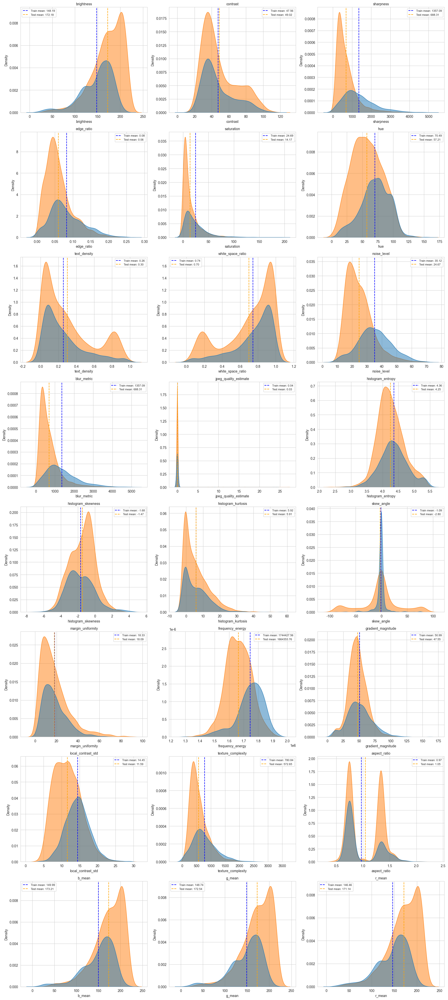

In [29]:
def plot_kde(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # KDE plot으로 전체적인 분포 형태 비교
    # 무엇을 봐야 하는가?
    # 1. 분포의 중심 이동: train과 test의 평균이 크게 다른가?
    # 2. 분포의 퍼짐: test가 train보다 더 넓게 퍼져있는가?
    # 3. 분포의 형태: 단봉/다봉, 왜도 차이가 있는가?
    # 4. 이상치: 한쪽 데이터셋에만 극단값이 있는가?
    fig, axes = plt.subplots(8, 3, figsize=(18, 40))
    axes = axes.flatten()

    for idx, feature in enumerate(features):
        ax = axes[idx]

        # KDE plot
        sns.kdeplot(data=combined_df, x=feature, hue="dataset", fill=True, alpha=0.5, ax=ax)

        # 평균선 추가
        train_mean = train_df[feature].mean()
        test_mean = test_df[feature].mean()
        ax.axvline(train_mean, color="blue", linestyle="--", label=f"Train mean: {train_mean:.2f}")
        ax.axvline(test_mean, color="orange", linestyle="--", label=f"Test mean: {test_mean:.2f}")

        ax.set_title(f"{feature}", fontsize=10)
        ax.legend(fontsize=8)

    plt.tight_layout()
    plt.show()


plot_kde(train_props_df, test_props_df, continuous_features)

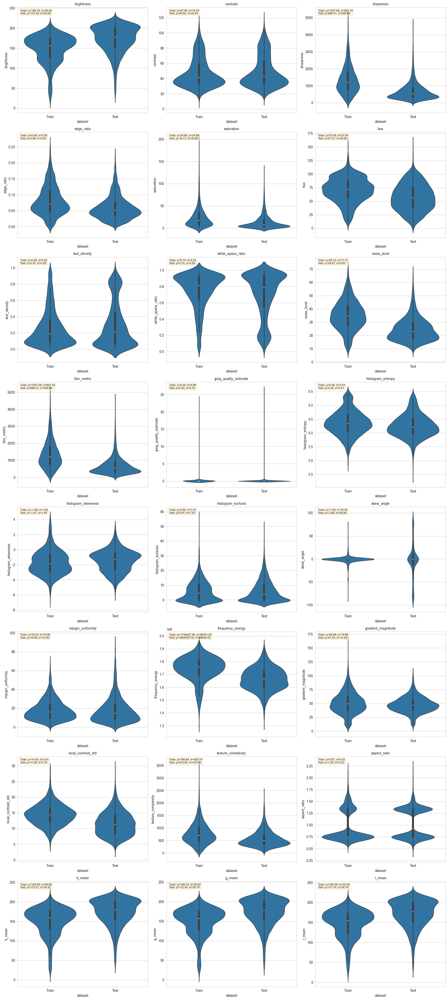

In [30]:
def plot_violin(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # Box plot과 Violin plot 결합
    # 무엇을 봐야 하는가?
    # 1. 중앙값(median) 차이: box 내부의 선 위치
    # 2. IQR(사분위수 범위) 차이: box의 크기
    # 3. 이상치: box 밖의 점들
    # 4. 분포의 대칭성: violin의 좌우 대칭 정도
    fig, axes = plt.subplots(8, 3, figsize=(18, 40))
    axes = axes.flatten()

    for idx, feature in enumerate(features):
        ax = axes[idx]

        # Violin plot with box plot inside
        sns.violinplot(data=combined_df, x="dataset", y=feature, inner="box", ax=ax)

        # 통계량 텍스트 추가
        train_stats = train_df[feature].describe()
        test_stats = test_df[feature].describe()

        stats_text = f"Train: μ={train_stats['mean']:.2f}, σ={train_stats['std']:.2f}\n"
        stats_text += f"Test: μ={test_stats['mean']:.2f}, σ={test_stats['std']:.2f}"

        ax.text(
            0.02,
            0.98,
            stats_text,
            transform=ax.transAxes,
            fontsize=8,
            verticalalignment="top",
            bbox={"boxstyle": "round", "facecolor": "wheat", "alpha": 0.5},
        )

        ax.set_title(f"{feature}", fontsize=10)

    plt.tight_layout()
    plt.show()


plot_violin(train_props_df, test_props_df, continuous_features)

In [31]:
integer_features = ["width", "height", "file_size_kb", "total_pixels"]

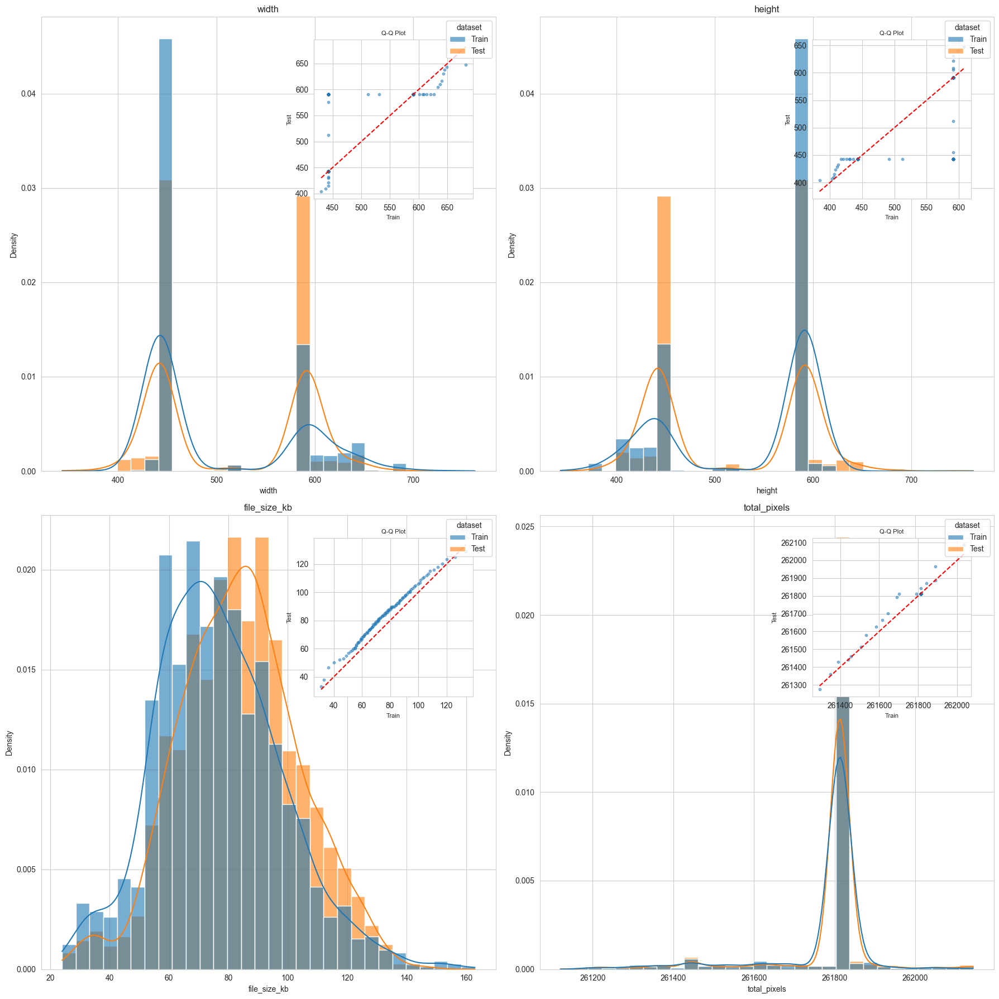

In [32]:
def plot_hist_with_kde(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # 히스토그램 + KDE
    # 무엇을 봐야 하는가?
    # 1. 빈도 분포의 차이: 특정 값에 몰려있는가?
    # 2. 범위의 차이: test에 새로운 범위의 값이 있는가?
    # 3. Q-Q plot: 대각선에서 벗어나면 분포가 다름
    fig, axes = plt.subplots(2, 2, figsize=(18, 18))
    axes = axes.flatten()

    for idx, feature in enumerate(features):
        ax = axes[idx]

        # Histogram with KDE overlay
        sns.histplot(
            data=combined_df,
            x=feature,
            hue="dataset",
            kde=True,
            stat="density",
            common_norm=False,
            bins=30,
            alpha=0.6,
            ax=ax,
        )

        # Q-Q plot을 inset으로 추가
        left, bottom, width, height = 0.6, 0.6, 0.35, 0.35
        ax_inset = ax.inset_axes([left, bottom, width, height])

        # Q-Q plot
        train_data = train_df[feature].dropna()
        test_data = test_df[feature].dropna()

        # 같은 분위수에서 비교
        quantiles = np.linspace(0.01, 0.99, 100)
        train_quantiles = np.quantile(train_data, quantiles)
        test_quantiles = np.quantile(test_data, quantiles)

        ax_inset.scatter(train_quantiles, test_quantiles, alpha=0.5, s=10)
        ax_inset.plot(
            [train_quantiles.min(), train_quantiles.max()],
            [train_quantiles.min(), train_quantiles.max()],
            "r--",
            label="y=x",
        )
        ax_inset.set_xlabel("Train", fontsize=8)
        ax_inset.set_ylabel("Test", fontsize=8)
        ax_inset.set_title("Q-Q Plot", fontsize=8)

        ax.set_title(f"{feature}", fontsize=12)

    plt.tight_layout()
    plt.show()


plot_hist_with_kde(train_props_df, test_props_df, integer_features)

In [33]:
categorical_features = ["color_mode", "is_rotated_90", "has_black_borders"]

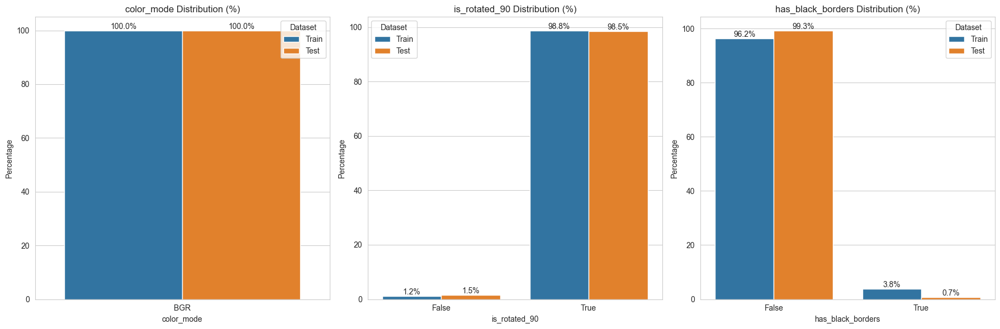

In [34]:
def plot_bar(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # 무엇을 봐야 하는가?
    # 1. 범주 비율의 차이: test에서 특정 범주가 급증했는가?
    # 2. 새로운 범주: test에만 있는 범주가 있는가?
    # 3. 불균형 정도: 한쪽 데이터셋이 더 불균형한가?
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    for idx, feature in enumerate(features):
        ax = axes[idx]

        # Count plot with percentages
        # 먼저 비율 계산
        train_counts = train_df[feature].value_counts(normalize=True) * 100
        test_counts = test_df[feature].value_counts(normalize=True) * 100

        # 데이터 준비
        plot_data = pd.DataFrame({"Train": train_counts, "Test": test_counts}).reset_index(names="Category")
        plot_data = plot_data.melt(id_vars="Category", var_name="Dataset", value_name="Percentage")

        # Bar plot
        sns.barplot(data=plot_data, x="Category", y="Percentage", hue="Dataset", ax=ax)

        # 수치 표시
        for container in ax.containers:
            ax.bar_label(container, fmt="%.1f%%")

        ax.set_title(f"{feature} Distribution (%)", fontsize=12)
        ax.set_xlabel(feature)
        ax.set_ylabel("Percentage")

    plt.tight_layout()
    plt.show()


plot_bar(train_props_df, test_props_df, categorical_features)

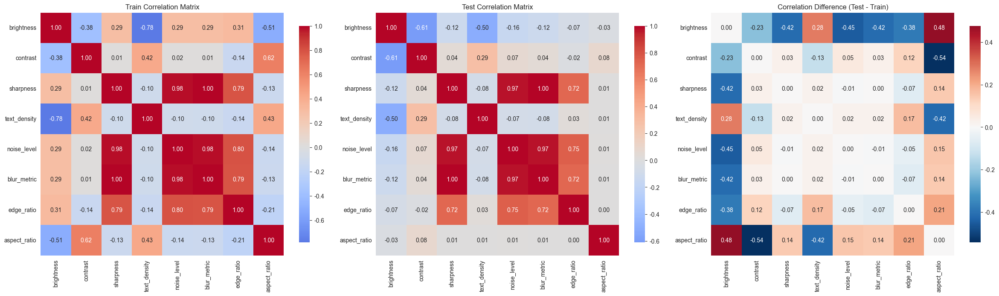

In [35]:
def plot_corr_diff(train_df: pd.DataFrame, test_df: pd.DataFrame):
    # Train과 Test의 상관관계 차이 시각화
    # 무엇을 봐야 하는가?
    # 1. 상관관계 부호 변화: 양의 상관이 음의 상관으로 바뀌었는가?
    # 2. 상관관계 강도 변화: 약한 상관이 강해졌는가?
    # 3. 새로운 상관관계: train에서는 독립적이었던 특성이 test에서는 상관성을 보이는가?
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 7))

    # 주요 특성 선택 (너무 많으면 보기 어려움)
    key_features = [
        "brightness",
        "contrast",
        "sharpness",
        "text_density",
        "noise_level",
        "blur_metric",
        "edge_ratio",
        "aspect_ratio",
    ]

    # Train 상관관계
    train_corr = train_df[key_features].corr()
    sns.heatmap(
        train_corr, annot=True, fmt=".2f", cmap="coolwarm", center=0, square=True, ax=ax1, cbar_kws={"shrink": 0.8}
    )
    ax1.set_title("Train Correlation Matrix")

    # Test 상관관계
    test_corr = test_df[key_features].corr()
    sns.heatmap(
        test_corr, annot=True, fmt=".2f", cmap="coolwarm", center=0, square=True, ax=ax2, cbar_kws={"shrink": 0.8}
    )
    ax2.set_title("Test Correlation Matrix")

    # 상관관계 차이
    corr_diff = test_corr - train_corr
    sns.heatmap(
        corr_diff, annot=True, fmt=".2f", cmap="RdBu_r", center=0, square=True, ax=ax3, cbar_kws={"shrink": 0.8}
    )
    ax3.set_title("Correlation Difference (Test - Train)")

    plt.tight_layout()
    plt.show()


plot_corr_diff(train_props_df, test_props_df)

In [36]:
numeric_features = [*continuous_features, *integer_features]

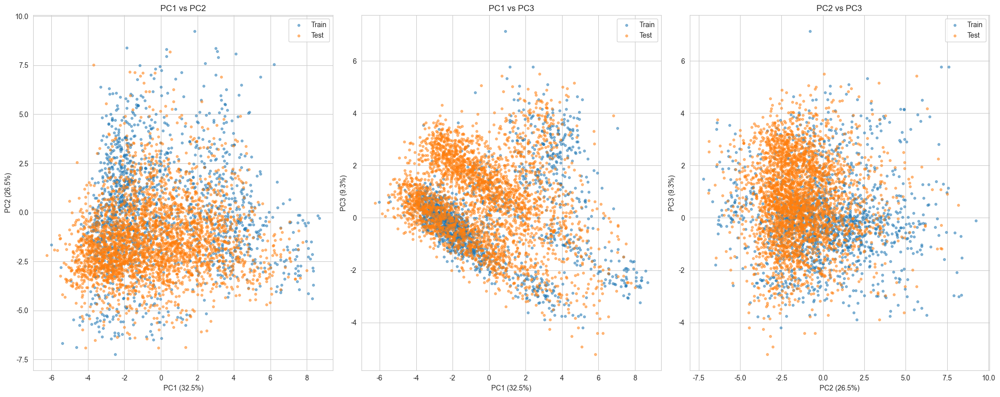

In [37]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


# 수치형 특성만 선택
def plot_pca_analysis(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # 무엇을 봐야 하는가?
    # 1. 분포의 중심 이동: test 데이터가 train과 다른 영역에 분포하는가?
    # 2. 분포의 퍼짐: test가 더 넓게 퍼져있는가?
    # 3. 클러스터: 특정 패턴이나 그룹이 보이는가?
    # 표준화
    scaler = StandardScaler()
    train_scaled = scaler.fit_transform(train_df[features])
    test_scaled = scaler.transform(test_df[features])  # train의 scaler 사용

    # PCA
    pca = PCA(n_components=3)
    train_pca = pca.fit_transform(train_scaled)
    test_pca = pca.transform(test_scaled)

    # 3D 산점도
    fig = plt.figure(figsize=(20, 8))

    # PC1 vs PC2
    ax1 = fig.add_subplot(131)
    ax1.scatter(train_pca[:, 0], train_pca[:, 1], alpha=0.5, label="Train", s=10)
    ax1.scatter(test_pca[:, 0], test_pca[:, 1], alpha=0.5, label="Test", s=10)
    ax1.set_xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.1%})")
    ax1.set_ylabel(f"PC2 ({pca.explained_variance_ratio_[1]:.1%})")
    ax1.legend()
    ax1.set_title("PC1 vs PC2")

    # PC1 vs PC3
    ax2 = fig.add_subplot(132)
    ax2.scatter(train_pca[:, 0], train_pca[:, 2], alpha=0.5, label="Train", s=10)
    ax2.scatter(test_pca[:, 0], test_pca[:, 2], alpha=0.5, label="Test", s=10)
    ax2.set_xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.1%})")
    ax2.set_ylabel(f"PC3 ({pca.explained_variance_ratio_[2]:.1%})")
    ax2.legend()
    ax2.set_title("PC1 vs PC3")

    # PC2 vs PC3
    ax3 = fig.add_subplot(133)
    ax3.scatter(train_pca[:, 1], train_pca[:, 2], alpha=0.5, label="Train", s=10)
    ax3.scatter(test_pca[:, 1], test_pca[:, 2], alpha=0.5, label="Test", s=10)
    ax3.set_xlabel(f"PC2 ({pca.explained_variance_ratio_[1]:.1%})")
    ax3.set_ylabel(f"PC3 ({pca.explained_variance_ratio_[2]:.1%})")
    ax3.legend()
    ax3.set_title("PC2 vs PC3")

    plt.tight_layout()
    plt.show()


plot_pca_analysis(train_props_df, test_props_df, numeric_features)

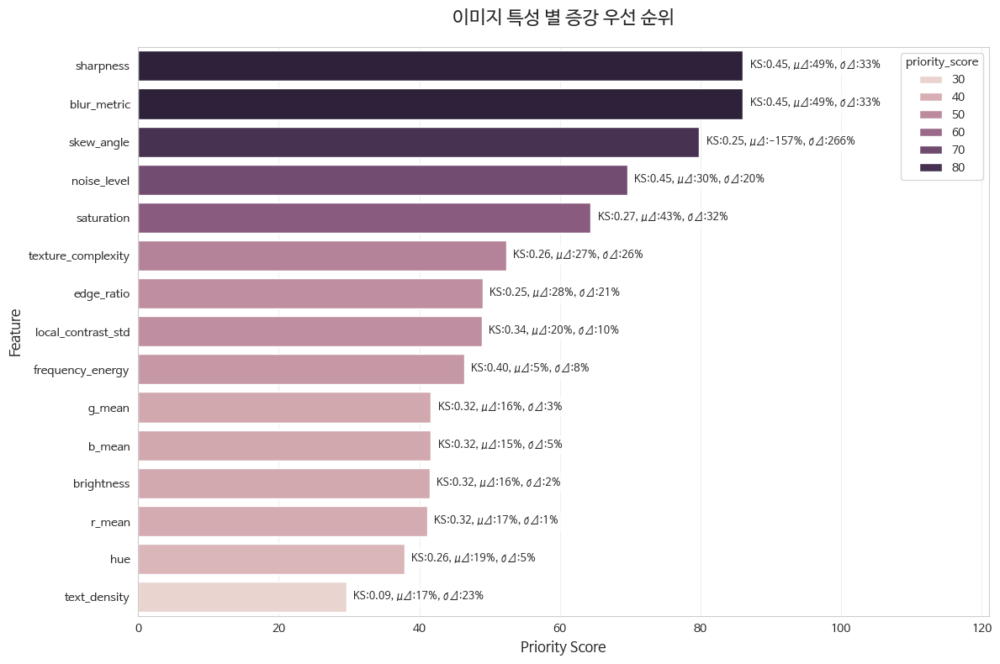

In [40]:
def calculate_statics(train_df: pd.DataFrame, test_df: pd.DataFrame, features: list):
    # 통계적 검정 수행
    # 무엇을 봐야 하는가?
    # 1. KS statistic > 0.1: 분포가 상당히 다름
    # 2. p-value < 0.05: 통계적으로 유의미한 차이
    # 3. Mean/Std diff > 20%: 실질적으로 큰 차이
    test_results = []

    for feature in features:
        train_data = train_df[feature].dropna()
        test_data = test_df[feature].dropna()

        # KS test
        ks_stat, ks_p = stats.ks_2samp(train_data, test_data)

        # Mann-Whitney U test (비모수)
        mw_stat, mw_p = stats.mannwhitneyu(train_data, test_data)

        # 평균과 표준편차 차이
        mean_diff_pct = abs(test_data.mean() - train_data.mean()) / train_data.mean() * 100
        std_diff_pct = abs(test_data.std() - train_data.std()) / train_data.std() * 100

        test_results.append(
            {
                "feature": feature,
                "ks_statistic": ks_stat,
                "ks_p_value": ks_p,
                "mw_p_value": mw_p,
                "mean_diff_%": mean_diff_pct,
                "std_diff_%": std_diff_pct,
                "significant": ks_p < 0.05,
            }
        )
    return pd.DataFrame(test_results).sort_values("ks_statistic", ascending=False)


def determine_augmentation_priority(statics_df: pd.DataFrame):
    # 증강 우선순위 매트릭스
    # 이 결과를 바탕으로:
    # 1. Priority score가 높은 특성들을 타겟으로 증강 설계
    # 2. 예: skew_angle이 높다면 → 회전 증강
    # 3. 예: noise_level이 높다면 → 노이즈 추가 증강
    # 4. 예: brightness가 높다면 → 밝기 조정 증강
    priority_scores = []

    for _, row in statics_df.iterrows():
        score = 0
        # KS statistic이 클수록 높은 점수
        score += row["ks_statistic"] * 100
        # 평균 차이가 클수록 높은 점수
        score += row["mean_diff_%"] * 0.5
        # 표준편차 차이가 클수록 높은 점수
        score += row["std_diff_%"] * 0.5

        priority_scores.append(
            {
                "feature": row["feature"],
                "priority_score": score,
                "ks_stat": row["ks_statistic"],
                "mean_diff": row["mean_diff_%"],
                "std_diff": row["std_diff_%"],
            }
        )

    priority_df = pd.DataFrame(priority_scores).sort_values("priority_score", ascending=False)

    # 우선순위 시각화
    plt.figure(figsize=(12, 8))
    # 상위 15개 특성만
    top_features = priority_df.head(15)

    # 막대 그래프 생성
    ax = sns.barplot(data=top_features, x="priority_score", y="feature", hue="priority_score", orient="h")

    # 각 막대에 텍스트 추가
    for idx, (_, row) in enumerate(top_features.iterrows()):
        # 텍스트 위치 계산
        x_pos = row["priority_score"] + 1  # 막대 끝에서 약간 오른쪽
        # 텍스트 생성
        text = f"KS:{row['ks_stat']:.2f}, μΔ:{row['mean_diff']:.0f}%, σΔ:{row['std_diff']:.0f}%"
        # 텍스트 추가
        ax.text(
            x_pos,
            idx,
            text,
            va="center",
            fontsize=9,
            bbox={"boxstyle": "round,pad=0.3", "facecolor": "white", "alpha": 0.7},
        )

    # 그래프 제목 및 레이블 설정
    plt.title("이미지 특성 별 증강 우선 순위", fontsize=16, fontweight="bold", pad=20)
    plt.xlabel("Priority Score", fontsize=12)
    plt.ylabel("Feature", fontsize=12)

    # x축 범위 조정 (텍스트가 잘 보이도록)
    plt.xlim(0, max(top_features["priority_score"]) + 35)

    # 그리드 스타일 조정
    ax.grid(True, axis="x", alpha=0.3)
    ax.set_axisbelow(True)

    plt.tight_layout()
    plt.show()


statistics = calculate_statics(train_props_df, test_props_df, numeric_features)
determine_augmentation_priority(statistics)

## 7. Train 의 Class 별 EDA

딥러닝에서 클래스별 분석이 필요한가?

딥러닝 모델은 자동으로 특징을 학습하므로, 전통적인 feature engineering 처럼 클래스별 특성을 세밀하게 분석할 필요는 **없다.**
하지만 다음과 같은 목적으로는 유용하다.

####  필요한 경우

- 클래스 불균형 확인
- 데이터 품질 문제 발견
- 혼동하기 쉬운 클래스 식별
- 클래스별 증강 전략 수립

### 클래스 불균형 분석

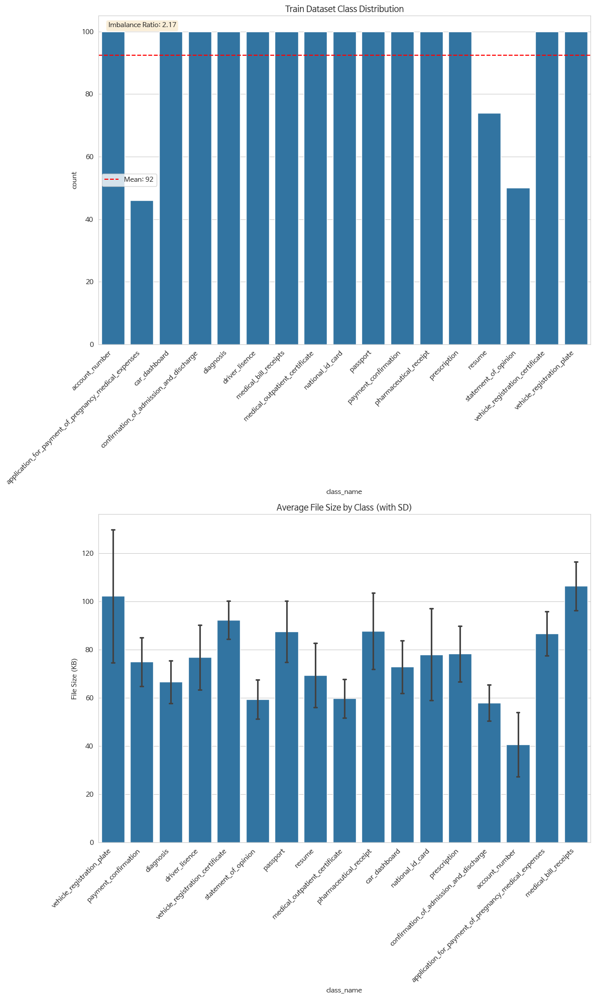

In [46]:
def analysis_balance_between_classes(train_df: pd.DataFrame, meta_df: pd.DataFrame):
    # 클래스별 샘플 수 시각화
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 20))

    # Train 클래스 분포
    train_counts = train_df["target"].value_counts().sort_index()
    train_counts.index = train_counts.index.map(meta_df["class_name"])

    # Seaborn barplot을 위한 데이터프레임 생성
    count_df = pd.DataFrame({"class_name": train_counts.index, "count": train_counts.to_numpy()})

    # 클래스 분포 시각화
    sns.barplot(data=count_df, x="class_name", y="count", ax=ax1)
    ax1.tick_params(axis="x", rotation=45)
    ax1.set_title("Train Dataset Class Distribution")
    ax1.axhline(y=train_counts.mean(), color="r", linestyle="--", label=f"Mean: {train_counts.mean():.0f}")
    ax1.legend()

    # 불균형 비율
    imbalance_ratio = train_counts.max() / train_counts.min()
    ax1.text(
        0.02,
        0.98,
        f"Imbalance Ratio: {imbalance_ratio:.2f}",
        transform=ax1.transAxes,
        verticalalignment="top",
        bbox={"boxstyle": "round", "facecolor": "wheat", "alpha": 0.5},
    )

    # 클래스별 평균 파일 크기
    file_size_df = train_df.copy()
    file_size_df["class_name"] = file_size_df["target"].map(meta_df["class_name"])

    sns.barplot(
        data=file_size_df, x="class_name", y="file_size_kb", estimator=np.mean, errorbar="sd", ax=ax2, capsize=0.1
    )
    ax2.tick_params(axis="x", rotation=45)
    ax2.set_title("Average File Size by Class (with SD)")
    ax2.set_ylabel("File Size (KB)")

    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45, ha="right")
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha="right")
    plt.tight_layout()
    plt.show()


analysis_balance_between_classes(train_props_df, class_meta_df)

### 클래스 간 유사도 매트릭스

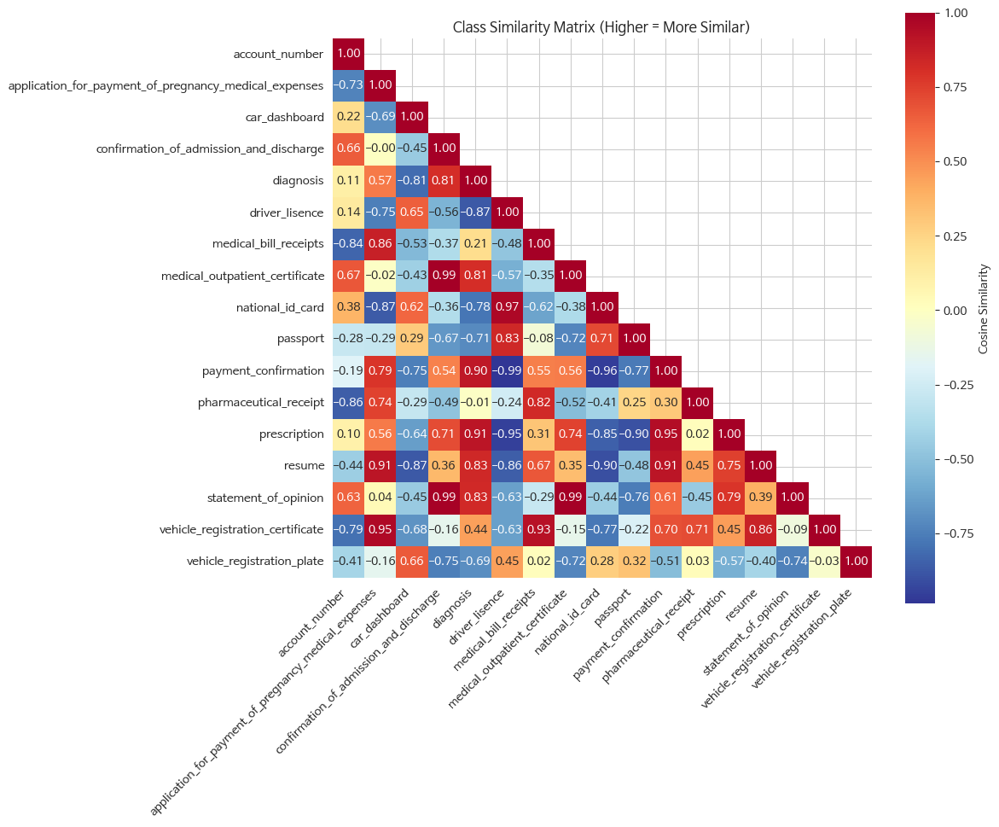

Highly similar class pairs:
medical_outpatient_certificate <-> statement_of_opinion: 0.995
confirmation_of_admission_and_discharge <-> medical_outpatient_certificate: 0.994
confirmation_of_admission_and_discharge <-> statement_of_opinion: 0.988
driver_lisence <-> national_id_card: 0.968
application_for_payment_of_pregnancy_medical_expenses <-> vehicle_registration_certificate: 0.954
payment_confirmation <-> prescription: 0.945
medical_bill_receipts <-> vehicle_registration_certificate: 0.930
application_for_payment_of_pregnancy_medical_expenses <-> resume: 0.914
diagnosis <-> prescription: 0.907
payment_confirmation <-> resume: 0.907


In [42]:
from sklearn.metrics.pairwise import cosine_similarity


def find_similar_pairs(train_df: pd.DataFrame, meta_df: pd.DataFrame):
    # 각 클래스의 평균 특성 벡터 계산
    feature_cols = ["brightness", "contrast", "text_density", "edge_ratio", "aspect_ratio", "sharpness", "noise_level"]

    # 클래스별 평균 특성
    class_features = train_df.groupby("target")[feature_cols].mean()

    # 표준화
    scaler = StandardScaler()
    class_features_scaled = scaler.fit_transform(class_features)

    # 코사인 유사도 계산
    similarity_matrix = cosine_similarity(class_features_scaled)

    # 시각화
    plt.figure(figsize=(12, 10))
    mask = np.triu(np.ones_like(similarity_matrix), k=1)

    # 클래스 이름으로 라벨 생성
    class_labels = [meta_df.loc[i, "class_name"] for i in range(17)]

    sns.heatmap(
        similarity_matrix,
        xticklabels=class_labels,
        yticklabels=class_labels,
        annot=True,
        fmt=".2f",
        cmap="RdYlBu_r",
        mask=mask,
        square=True,
        cbar_kws={"label": "Cosine Similarity"},
    )
    plt.xticks(rotation=45, ha="right")
    plt.yticks(rotation=0)
    plt.title("Class Similarity Matrix (Higher = More Similar)")
    plt.tight_layout()
    plt.show()

    # 가장 유사한 클래스 쌍 찾기
    similar_pairs = []
    for i in range(17):
        for j in range(i + 1, 17):
            if similarity_matrix[i, j] > 0.9:
                similar_pairs.append(
                    (meta_df.loc[i, "class_name"], meta_df.loc[j, "class_name"], similarity_matrix[i, j])
                )

    print("Highly similar class pairs:")
    for pair in sorted(similar_pairs, key=lambda x: x[2], reverse=True):
        print(f"{pair[0]} <-> {pair[1]}: {pair[2]:.3f}")


find_similar_pairs(train_props_df, class_meta_df)

### 클래스별 특이점 탐지

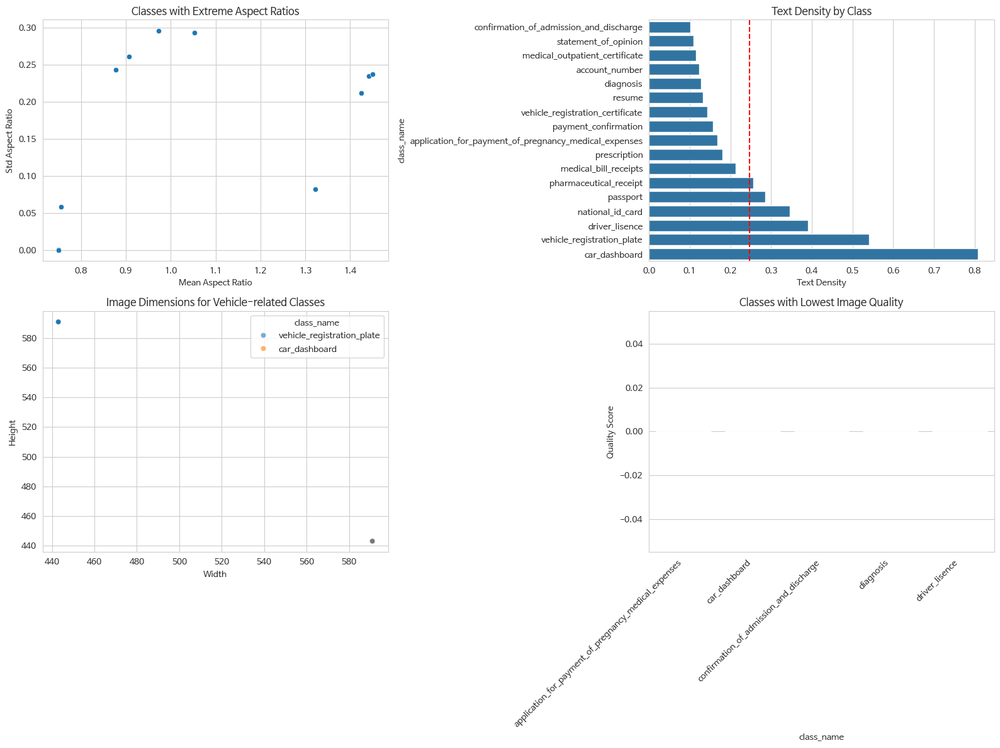

In [43]:
def detect_singularity_between_classes(train_df: pd.DataFrame, meta_df: pd.DataFrame):
    # 데이터에 클래스 이름 추가
    train_df_with_names = train_df.copy()
    train_df_with_names["class_name"] = train_df_with_names["target"].map(meta_df["class_name"])

    fig, axes = plt.subplots(2, 2, figsize=(16, 12))

    # 1. 극단적인 aspect_ratio를 가진 클래스
    aspect_stats = train_df_with_names.groupby("class_name")["aspect_ratio"].agg(["mean", "std"]).reset_index()

    sns.scatterplot(data=aspect_stats, x="mean", y="std", ax=axes[0, 0])
    # 극단값 라벨 추가
    for _, row in aspect_stats.iterrows():
        if row["mean"] > 1.5 or row["mean"] < 0.7:
            axes[0, 0].annotate(row["class_name"], (row["mean"], row["std"]), fontsize=8)
    axes[0, 0].set_xlabel("Mean Aspect Ratio")
    axes[0, 0].set_ylabel("Std Aspect Ratio")
    axes[0, 0].set_title("Classes with Extreme Aspect Ratios")

    # 2. 텍스트 밀도가 특이한 클래스
    text_density_df = train_df_with_names.groupby("class_name")["text_density"].mean().reset_index()
    text_density_df = text_density_df.sort_values("text_density")

    sns.barplot(data=text_density_df, y="class_name", x="text_density", ax=axes[0, 1])
    axes[0, 1].axvline(x=text_density_df["text_density"].mean(), color="r", linestyle="--")
    axes[0, 1].set_xlabel("Text Density")
    axes[0, 1].set_title("Text Density by Class")

    # 3. 클래스별 이미지 크기 분포 (차량 관련 클래스)
    vehicle_classes = ["car_dashboard", "vehicle_registration_plate"]
    vehicle_data = train_df_with_names[train_df_with_names["class_name"].isin(vehicle_classes)]

    sns.scatterplot(data=vehicle_data, x="width", y="height", hue="class_name", alpha=0.6, ax=axes[1, 0])
    axes[1, 0].set_xlabel("Width")
    axes[1, 0].set_ylabel("Height")
    axes[1, 0].set_title("Image Dimensions for Vehicle-related Classes")

    # 4. 품질 지표가 낮은 클래스
    quality_df = train_df_with_names.groupby("class_name")[["sharpness", "jpeg_quality_estimate"]].mean()
    quality_df["quality_score"] = quality_df["sharpness"] * quality_df["jpeg_quality_estimate"] / 100
    worst_quality = quality_df.nsmallest(5, "quality_score").reset_index()

    sns.barplot(data=worst_quality, x="class_name", y="quality_score", hue="class_name", ax=axes[1, 1])
    axes[1, 1].tick_params(axis="x", rotation=45)
    axes[1, 1].set_ylabel("Quality Score")
    axes[1, 1].set_title("Classes with Lowest Image Quality")
    plt.setp(axes[1, 1].xaxis.get_majorticklabels(), rotation=45, ha="right")

    plt.tight_layout()
    plt.show()


detect_singularity_between_classes(train_props_df, class_meta_df)

### 클래스별 증강 필요성 분석

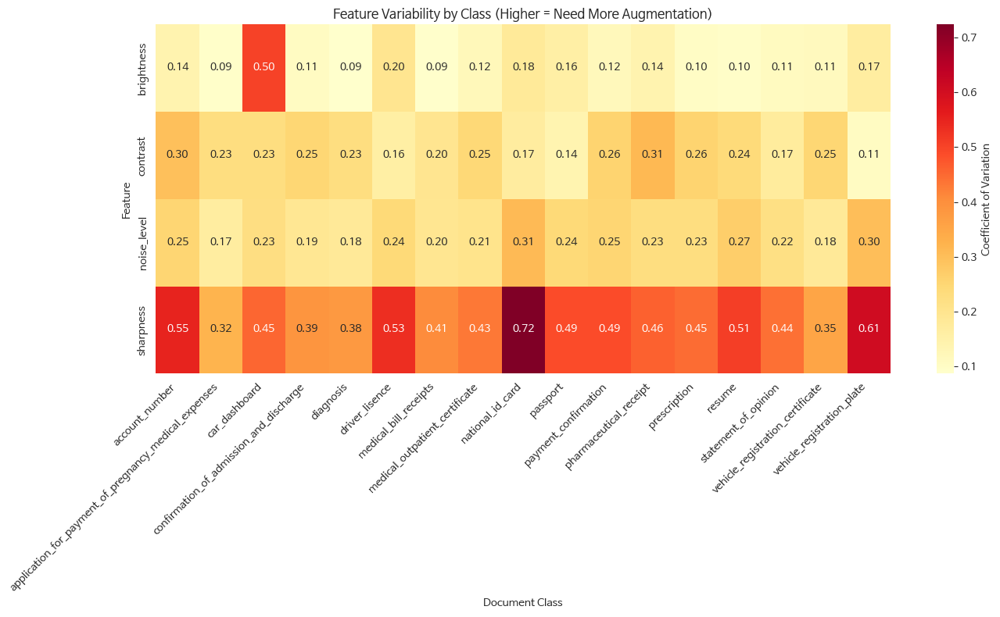


Classes requiring more aggressive augmentation:
- car_dashboard: variability score = 0.353
- national_id_card: variability score = 0.346
- account_number: variability score = 0.310
- vehicle_registration_plate: variability score = 0.296
- pharmaceutical_receipt: variability score = 0.285


In [44]:
def analyze_which_classes_needed_augmentation(train_df: pd.DataFrame, meta_df: pd.DataFrame):
    # 클래스별 변동성 분석
    features_to_analyze = ["brightness", "contrast", "sharpness", "noise_level"]
    variability_data = []

    for class_id in range(17):
        class_data = train_df[train_df["target"] == class_id]
        class_name = meta_df.loc[class_id, "class_name"]

        for feature in features_to_analyze:
            mean_val = class_data[feature].mean()
            std_val = class_data[feature].std()
            cv = std_val / mean_val if mean_val > 0 else 0

            variability_data.append({"class_name": class_name, "feature": feature, "cv": cv})

    variability_df = pd.DataFrame(variability_data)
    variability_pivot = variability_df.pivot(index="feature", columns="class_name", values="cv")

    # 히트맵으로 시각화
    plt.figure(figsize=(14, 8))
    ax = sns.heatmap(
        variability_pivot, annot=True, fmt=".2f", cmap="YlOrRd", cbar_kws={"label": "Coefficient of Variation"}
    )
    plt.xticks(rotation=45, ha="right")
    plt.title("Feature Variability by Class (Higher = Need More Augmentation)")
    plt.xlabel("Document Class")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()

    # 증강 권장사항 출력
    mean_variability = variability_pivot.mean().sort_values(ascending=False).head(5)
    print("\nClasses requiring more aggressive augmentation:")
    for class_name, score in mean_variability.items():
        print(f"- {class_name}: variability score = {score:.3f}")


analyze_which_classes_needed_augmentation(train_props_df, class_meta_df)

### 종합 대시보드

/Users/joyuiyeong/.pyenv/versions/deeplearning/lib/python3.11/site-packages/sklearn/manifold/_mds.py:677: FutureWarning: The default value of `n_init` will change from 4 to 1 in 1.9.
  warnings.warn(


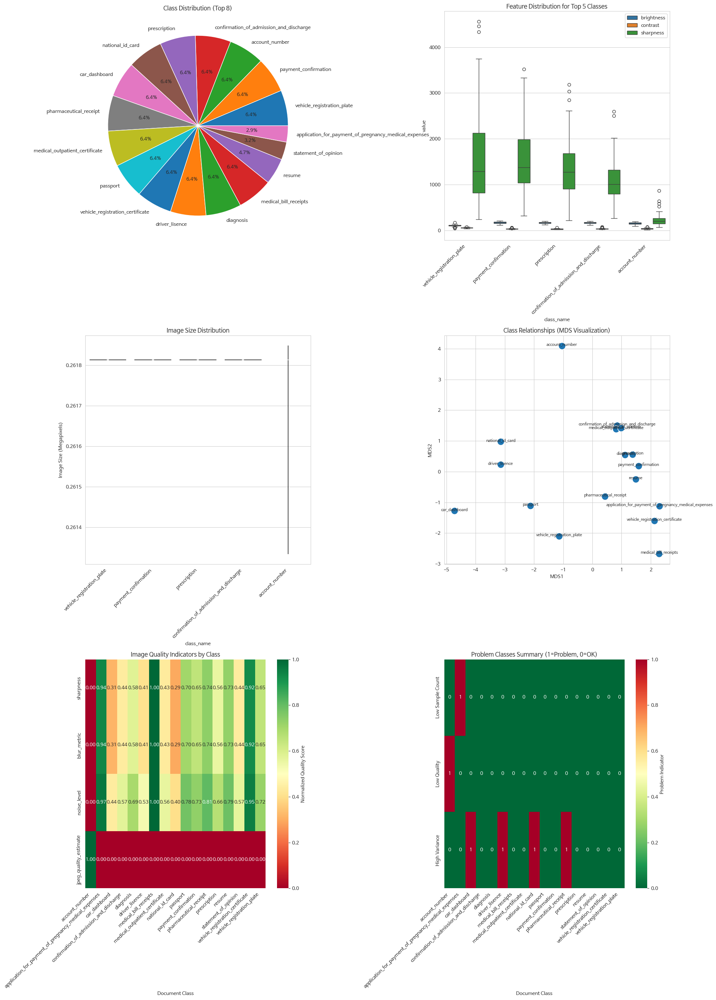

In [45]:
from sklearn.manifold import MDS


def summarize_classes(train_df: pd.DataFrame, meta_df: pd.DataFrame):
    counts_per_target = train_df["target"].value_counts()
    grouped_train_df = train_df.groupby("target")

    low_sample_count = counts_per_target < counts_per_target.mean() * 0.5
    low_quality = grouped_train_df["sharpness"].mean() < train_df["sharpness"].quantile(0.25)
    high_variance = grouped_train_df["brightness"].std() > grouped_train_df["brightness"].std().quantile(0.75)

    problem_summary = pd.DataFrame(
        {
            "Low Sample Count": low_sample_count,
            "Low Quality": low_quality,
            "High Variance": high_variance,
        }
    )
    problem_summary.index = problem_summary.index.map(meta_df["class_name"])
    return problem_summary


def plot_dashboard(train_df: pd.DataFrame, meta_df: pd.DataFrame, feature_cols: list):
    train_df_with_names = train_df.copy()
    train_df_with_names["class_name"] = train_df_with_names["target"].map(meta_df["class_name"])
    # 클래스별 주요 지표 종합
    fig, axes = plt.subplots(3, 2, figsize=(20, 28))

    # 1. 클래스 분포 (파이 차트)
    class_counts = train_df["target"].value_counts()
    class_counts.index = class_counts.index.map(meta_df["class_name"])
    axes[0, 0].pie(class_counts.values, labels=class_counts.index, autopct="%1.1f%%")
    axes[0, 0].set_title("Class Distribution (Top 8)")

    # 2. 클래스별 평균 특성 (박스플롯)
    feature_comparison = train_df_with_names[["class_name", "brightness", "contrast", "sharpness"]]
    feature_melt = feature_comparison.melt(id_vars="class_name", var_name="feature", value_name="value")

    # 샘플 수가 많은 상위 5개 클래스만 선택
    top_5_classes = train_df["target"].value_counts().head(5).index
    top_5_class_names = [meta_df.loc[idx, "class_name"] for idx in top_5_classes]
    feature_melt_filtered = feature_melt[feature_melt["class_name"].isin(top_5_class_names)]

    sns.boxplot(data=feature_melt_filtered, x="class_name", y="value", hue="feature", ax=axes[0, 1])
    axes[0, 1].tick_params(axis="x", rotation=45)
    axes[0, 1].set_title("Feature Distribution for Top 5 Classes")
    axes[0, 1].legend(loc="upper right")
    plt.setp(axes[0, 1].xaxis.get_majorticklabels(), rotation=45, ha="right")

    # 3. 클래스별 이미지 크기 분포 (violin plot)
    size_data = train_df_with_names[train_df_with_names["class_name"].isin(top_5_class_names)].copy()
    size_data["image_size"] = size_data["width"] * size_data["height"] / 1000000  # 메가픽셀

    sns.violinplot(data=size_data, x="class_name", y="image_size", ax=axes[1, 0])
    axes[1, 0].tick_params(axis="x", rotation=45)
    axes[1, 0].set_ylabel("Image Size (Megapixels)")
    axes[1, 0].set_title("Image Size Distribution")
    plt.setp(axes[1, 0].xaxis.get_majorticklabels(), rotation=45, ha="right")

    # 4. 클래스 간 거리 (MDS)
    # 클래스별 평균 특성으로 거리 계산
    class_features = train_df.groupby("target")[feature_cols].mean()
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(class_features)

    # MDS로 2D 변환
    mds = MDS(n_components=2, dissimilarity="euclidean", random_state=42)
    class_positions = mds.fit_transform(scaled_features)

    # 시각화
    scatter_df = pd.DataFrame(class_positions, columns=["MDS1", "MDS2"])
    scatter_df["class_name"] = [meta_df.loc[i, "class_name"] for i in range(17)]

    sns.scatterplot(data=scatter_df, x="MDS1", y="MDS2", s=200, ax=axes[1, 1])
    for _, row in scatter_df.iterrows():
        axes[1, 1].annotate(row["class_name"], (row["MDS1"], row["MDS2"]), fontsize=8, ha="center")
    axes[1, 1].set_title("Class Relationships (MDS Visualization)")

    # 5. 품질 지표 히트맵
    quality_features = ["sharpness", "blur_metric", "noise_level", "jpeg_quality_estimate"]
    quality_df = train_df_with_names.groupby("class_name")[quality_features].mean()

    # 정규화 (0-1)
    quality_normalized = (quality_df - quality_df.min()) / (quality_df.max() - quality_df.min())

    ax5 = sns.heatmap(
        quality_normalized.T,
        cmap="RdYlGn",
        annot=True,
        fmt=".2f",
        cbar_kws={"label": "Normalized Quality Score"},
        ax=axes[2, 0],
    )
    ax5.tick_params(axis="x", rotation=45)
    ax5.set_xlabel("Document Class")
    ax5.set_title("Image Quality Indicators by Class")
    plt.setp(ax5.xaxis.get_majorticklabels(), rotation=45, ha="right")

    # 6. 문제 클래스 요약
    problem_summary = summarize_classes(train_df, meta_df)
    ax6 = sns.heatmap(
        problem_summary.T, cmap="RdYlGn_r", annot=True, fmt="d", cbar_kws={"label": "Problem Indicator"}, ax=axes[2, 1]
    )
    ax6.tick_params(axis="x", rotation=45)
    ax6.set_xlabel("Document Class")
    ax6.set_title("Problem Classes Summary (1=Problem, 0=OK)")
    plt.setp(ax6.xaxis.get_majorticklabels(), rotation=45, ha="right")

    plt.tight_layout()
    plt.show()


plot_dashboard(
    train_props_df,
    class_meta_df,
    feature_cols=["brightness", "contrast", "text_density", "edge_ratio", "aspect_ratio", "sharpness", "noise_level"],
)